In [34]:
###### Setup ######

import matplotlib.pyplot as plt
import pandas as pd
import numpy as np

# Get Data For Plotting
!git clone https://github.com/HenrikSDU/30.202-SUTD-IC-Design.git
%cd 30.202-SUTD-IC-Design/Current_Starved_Ring_OSC_Design/simulation_data
!ls
DIR = "/content/30.202-SUTD-IC-Design/Current_Starved_Ring_OSC_Design/simulation_data/"
# As this runs on a colab - if you want to run it locally you may want to change this directory,
# replace /content with your run directory! ~ Aish, Henrik, Jalen


Cloning into '30.202-SUTD-IC-Design'...
remote: Enumerating objects: 27, done.
remote: Counting objects: 100% (27/27), done.
remote: Compressing objects: 100% (20/20), done.
remote: Total 27 (delta 4), reused 26 (delta 3), pack-reused 0 (from 0)
Receiving objects: 100% (27/27), done.
Resolving deltas: 100% (4/4), done.
/content/30.202-SUTD-IC-Design/Current_Starved_Ring_OSC_Design/simulation_data/30.202-SUTD-IC-Design/Current_Starved_Ring_OSC_Design/simulation_data/30.202-SUTD-IC-Design/Current_Starved_Ring_OSC_Design/simulation_data/30.202-SUTD-IC-Design/Current_Starved_Ring_OSC_Design/simulation_data/30.202-SUTD-IC-Design/Current_Starved_Ring_OSC_Design/simulation_data
freq_vs_vctrl0512.csv			   freq_vs_vctr_wRCl0812.csv
freq_vs_vctrl2611.csv			   pwr_vs_vctrl0512.csv
freq_vs_vctr_parabalanced_1312mod.csv	   pwr_vs_vctrl2611.csv
freq_vs_vctr_parabalanced_wRCI1312.csv	   pwr_vs_vctr_parabalanced_1212.csv
freq_vs_vctr_parabalanced_wRCI1312mod.csv  pwr_vs_vctr_wRCl0812.csv
freq_vs_vctr_

# **2D Programmable Ring Oscillator For 30.202**

## Prepared by Group 2

#### Group Members:
#### Henrik Maarten Bongers, 1009526
#### Muhamad Aish Bin Sabaruddin, 1006352
#### Mateo Jalen Andrew Calderon, 1006042

### Table of Contents
1. Introduction
2. Circuit Design
3. Conclusion
4. References
5. Appendices


# **1. Introduction**
This report details the design and implementation of a Programmable Ring Oscillator (PRO). Programmable Ring Oscillators are versatile and can be used in digital and analog domains. This is due to the fact that the Voltage Control is able to alter the output frequency of the oscillator.
The primary goal of this project is to design and construct a programmable ring oscillator, with a focus on design rule checking, layout versus schematics tests and simulation results. We centred the design around a 3 stage ring oscillator circuit for this 2D project.

$$$$

In this report, for the sake of clarity and adherance to the rubrics, we have included the screenshots of the relevant details of the project from Cadence in each section.

$$$$

In the appendices, we have also included some of our other work related to this project, which are the stick diagram, additional python calculations and schematic drawings using python, and alternative/earlier designs which helped us in this project.

# **2. Circuit Design**
#  2.1 Design Considerations & Circuit Schematic
The aim of this project is a design that follows the following design objectives:

- Minimize Area
- Maintain Output Stability
- Maintain Circuit Stability
- Power efficiency

The circuit design for a programmable ring oscillator in this project is the current-starved voltage controlled ring oscillator. This ring oscillator design provides several advantages over the simple basic ring oscillator. Most importantly, the frequency is controllable, which is design requirement in this project.

In the basic ring oscillator the frequency is controlled by the propagation delay of the inverter stages. This delay is determined by the time it takes to charge the capacitive load of each stage. Thus, by decreasing or increasing the charging current, the delay can be increased or decreased, respectively. This delay then impacts the oscillation frequency. This limiting of current can be done using current mirrors. These thoughts lead to the basic current-starved ring oscillator design (shown below). By limiting the current, the power can also be reduced, which is one of the design goals.

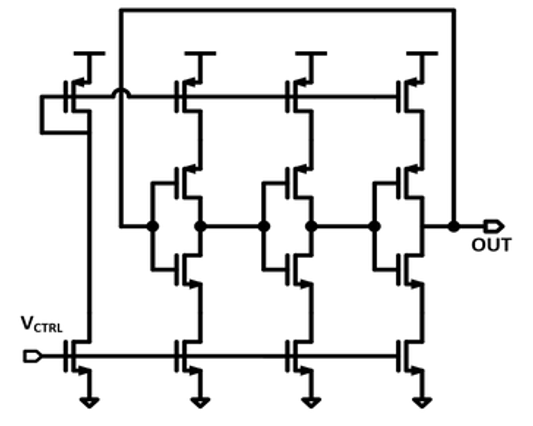

(image taken from individual preview questions)

The frequency of this current-starved ring oscillator is governed by the following equations [1]:

$$ f_{out} = \frac{I_d}  {2 * N * C_{total} * V_{ctrl}}  $$

$$$$
where $f_{out}$ is the output frequency, $I_d$ available for charging the capacative load of the next stage and $C_{total}$ is $C_{in} + C_{out}$ of the inverter.

$C_{total}$ is commonly estimated as:
$$ C_{total} = \frac{5}{2} * C_{ox} (W_p L_p  + W_n L_n)$$


## Expanding the basic current-starved ring oscillator
*Note: This project went through several design iterations, each design addressing the weaknesses of the previous, for now the final design will be discussed. For previous iterations refer to appendix.*

Using Cadence, we made the schematic for our circuit. Do note that for the stability and strength of the output signal, we add 2 inverters as a buffer to the output. In doing so, there is also load isolation, increased drive capacity for external loads and a consistency in phase with the original oscillaor signal (as compared to having just 1 inverter as a buffer). This is in accordance with the design goals.

However, by adding this buffer stage to just the output, this node of the OSC will see a higher capacitive load than the others. To ensure stability of the circuit the capacitive load of each stage must be the same. Only this way there is an equal delay at each stage.

Hence, to satisfy the design goals, the capacitive load at each stage must be equal. To achieve that, this projects design adds dummy loads in the form of extra output buffers at the other nodes.

The design will be implemented in CMOS 0.35 μm technology.
The final schematic can be seen below:




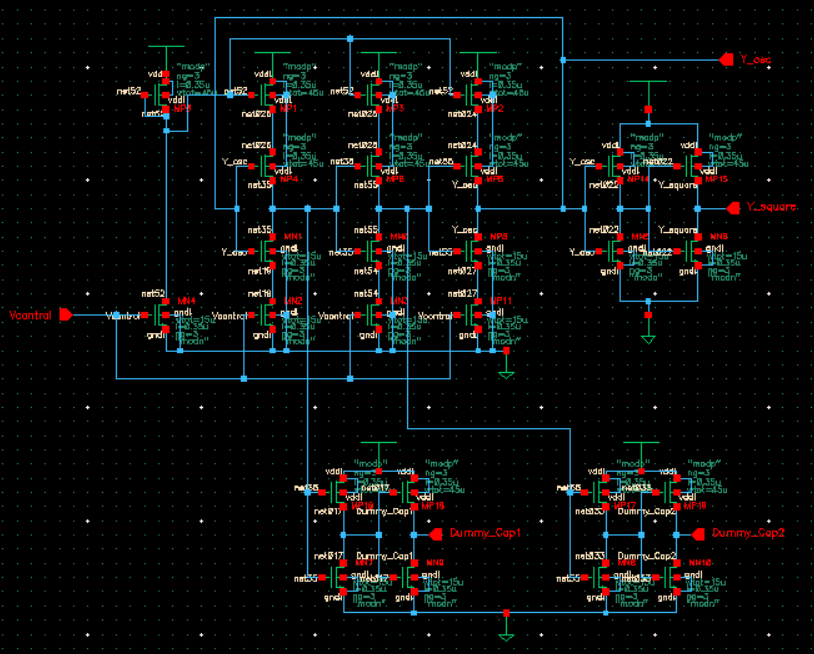

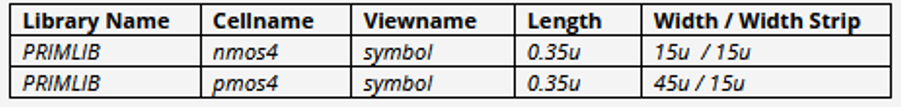

*Note: in our design the width strip of the nmos is 5$\mu m$*

## 2.2 Simulation

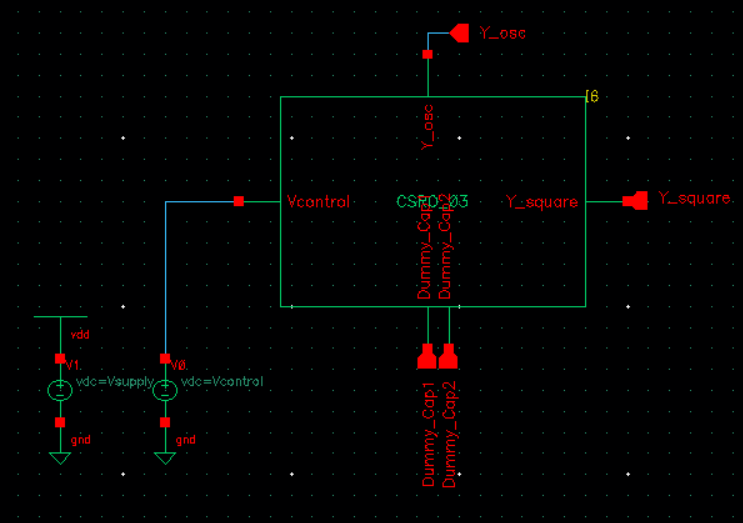


### 2.2.1 Simulation under typical operating conditions
The given parameters for typical conditions are:

- $V_{DD}$ = 3.31 V

- $V_{ctrl}$ = 1.0V

- Temperature = 38°C

*Note: As an convergence aid Y_osc is set to 1.8V as an initial condition.*

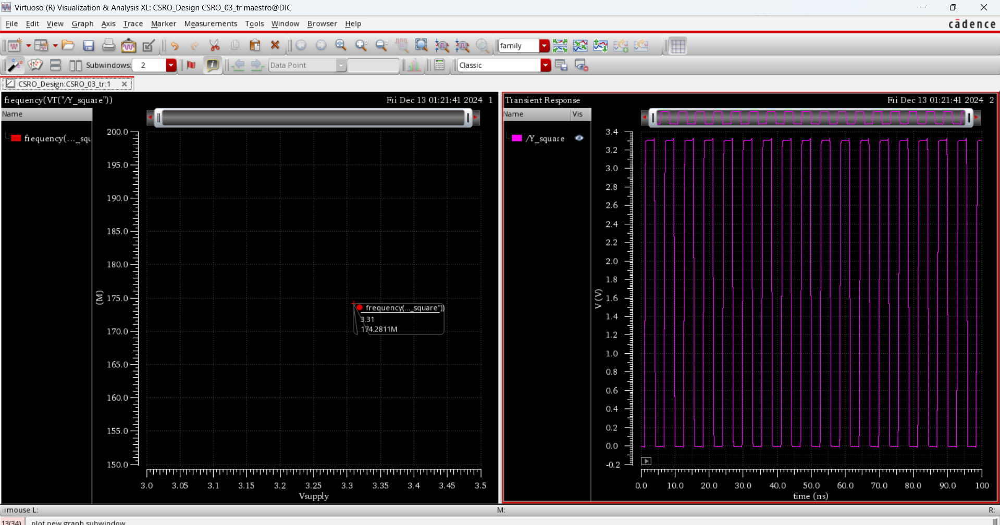

With these typical operating conditions the frequency is expected to be 174.3 MHz. The square outputwave can be observed on the right.

### 2.2.2 Simulation for $V_{ctrl}$: 0.7-1.4V

Using Cadence Maestro the frequency and different waveforms can be simulated.

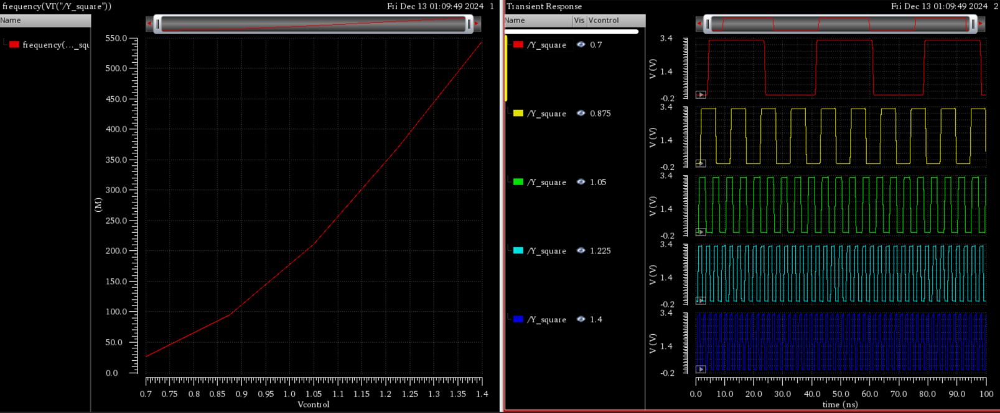

#### Plotting Frequency vs. $V_{ctrl}$

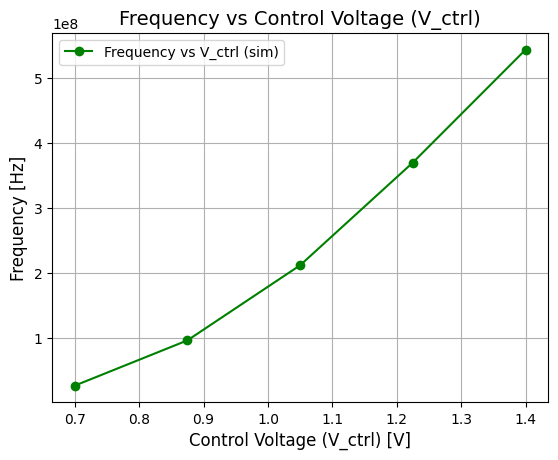

In [35]:
csv_file = 'freq_vs_vctr_parabalanced_1312mod.csv'

data = pd.read_csv(DIR+csv_file)

# Extract the data
freq_x = data['frequency(VT("/Y_square")) X']
freq_y = data['frequency(VT("/Y_square")) Y']

# Create the plot
plt.plot(freq_x, freq_y, marker='o', linestyle='-', color='g', label='Frequency vs V_ctrl (sim)')

plt.title('Frequency vs Control Voltage (V_ctrl)', fontsize=14)
plt.xlabel('Control Voltage (V_ctrl) [V]', fontsize=12)
plt.ylabel('Frequency [Hz]', fontsize=12)
plt.grid(True)
plt.legend()


From these plots done on python, we note that generally as control voltage increases, the output frequency also increases. This could be attributed to the fact that a higher control voltage increases the current through inverter stages, reducing the oscillation period and increasing the frequency.

### Note on Power
As can be seen from the simulation data below (which is plotted using Python), the average power increases with frequency!

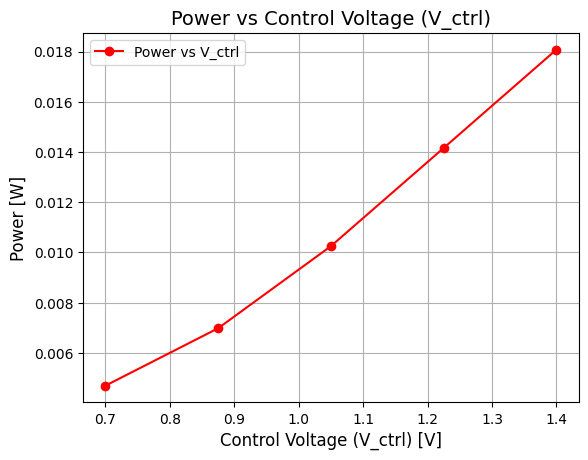

In [36]:
csv_file = 'pwr_vs_vctr_parabalanced_1212.csv'
data_wRC = pd.read_csv(DIR+csv_file)
# Extract the data
power_x = data_wRC['Power X']
power_y = data_wRC['Power Y']

plt.plot(power_x, power_y, marker='o', linestyle='-', color='r', label='Power vs V_ctrl')

plt.title('Power vs Control Voltage (V_ctrl)', fontsize=14)
plt.xlabel('Control Voltage (V_ctrl) [V]', fontsize=12)
plt.ylabel('Power [W]', fontsize=12)
plt.grid(True)
plt.legend()

## 2.3 Layout
### 2.3.1 Thoughts, considerations and objectives

For the layout of the ring oscillator, followed the conceptual stick diagram we made, found in Appendix C.

We also prioritised minimising the area of the chip, as in modern IC-design, area is rescources and money. The annotated layout can be seen below. The design gets power from the VDD! rail in the top and the GND! rail in the bottom. The core of the ring oscillator is formed by the three inverter stages at its heart. Here highlighted in light-blue.

To minimize the path and propagation delay from the last inverter stage is connected back using the Metal-2 layer. Through going one layer up, the path length can be significantly shortened and the saved space remains for the other elements of the design. The current mirror elements, higlighted in orange, can be found in the top (pmos) and bottom (nmos). The current mirror also uses Metal-2 to connect pmos and nmos. This way the output buffer can be placed tightly in the otherwise remaining gap. The output buffer is colored in purple here. Last but not least, the parasitics balancing section containing the two "dummy" buffers can be found at the right, highlighted in green.

All pmos-transistors share the same nwell, this way the individual transistors can be placed more tightly together without violating design rules and can share substrate contacts.

#### Annotated View

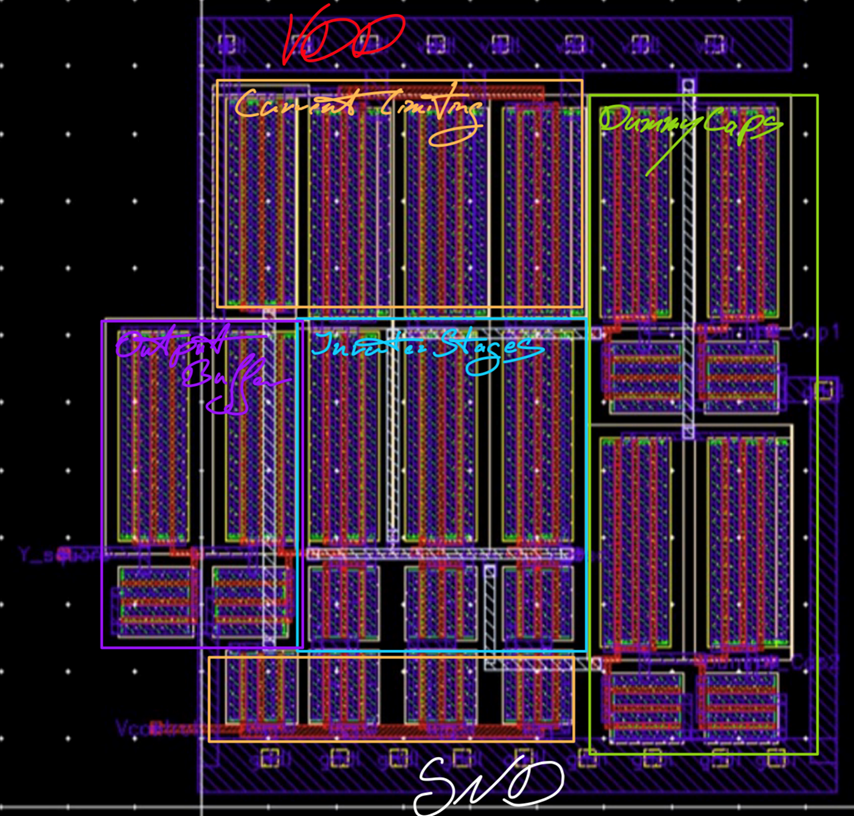

#### Unannotated View

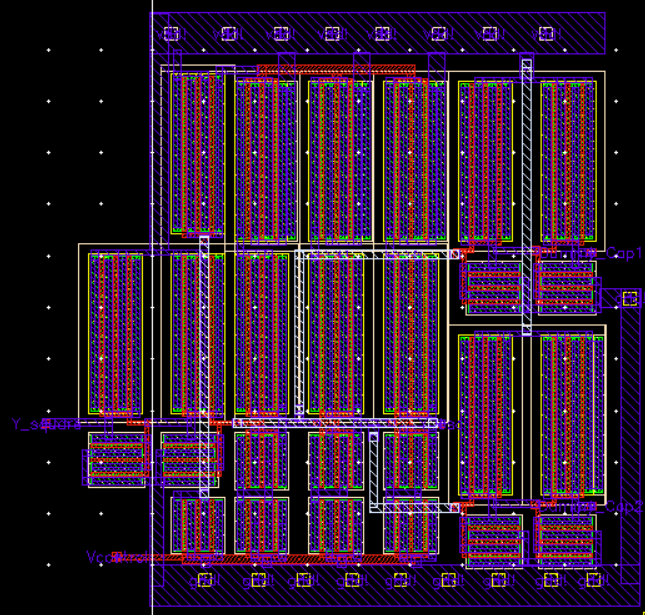

#### Connections View

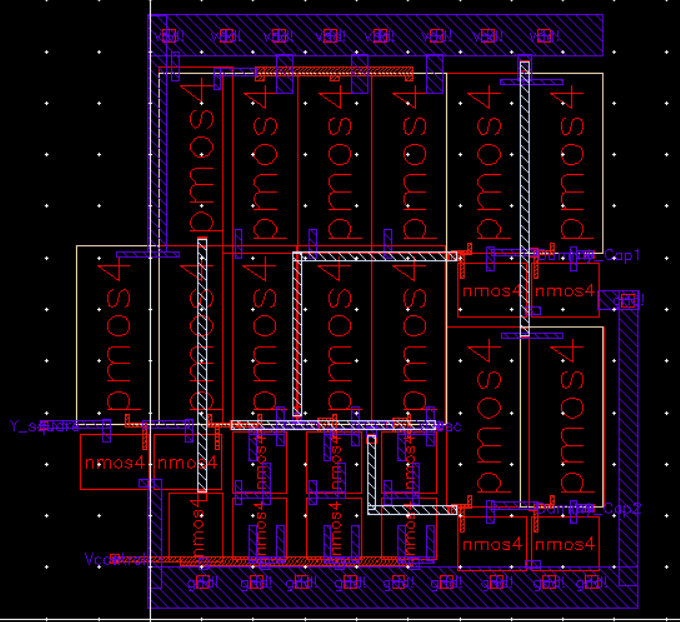

### 2.3.2 Layout-Area

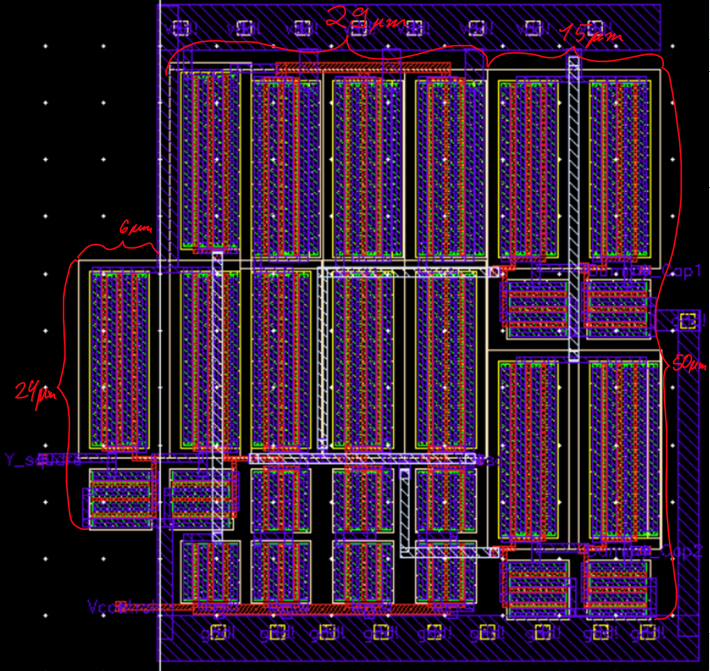

The layout area has three main components: $Area_{CSRO}$, $Area_{overlap-outputbuffer}$ and $Area_{Dummy-Caps}$:

$$ Area_{Layout} = Area_{overlap-outputbuffer} + Area_{CSRO} + Area_{Dummy-Caps} $$

$$ Area_{Layout} = 6 \mu m * 24 \mu m + 29 \mu m * 50 \mu + 15 \mu m * 50 \mu m$$

$$ Area_{Layout}  = 2,344 \mu m^2$$

### 2.3.3 DRC

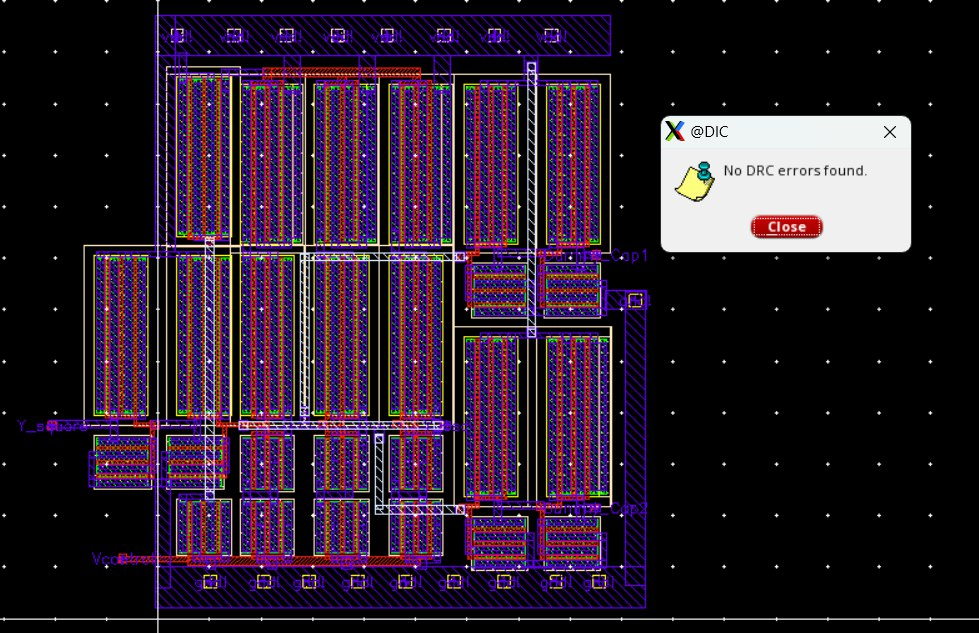

### 2.3.4 LVS

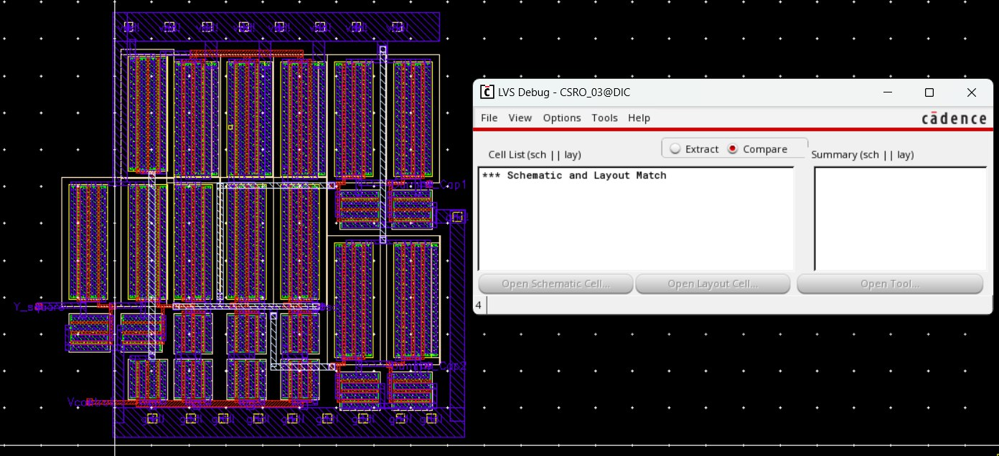

### 2.3.5 QRC - Parasitc extraction
To finally evaluate the layout, the parasitics have to be extracted. This can be done using Quantus in Cadence.

For this project, it was chosen to extract parasitic capacitances and resistances. All parasitcs were extracted with reference to the gnd! node. As a boundary condition 38°C were set in accordance with the typical operating conditions.

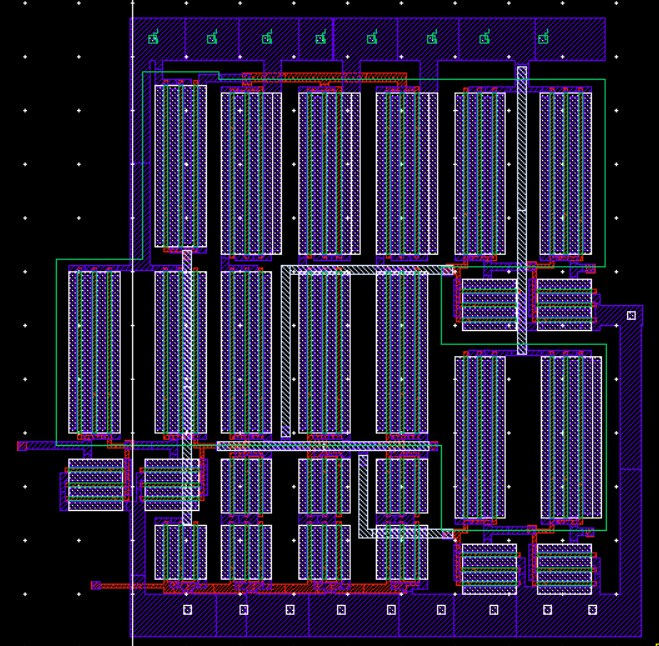

#### Example in detail view:

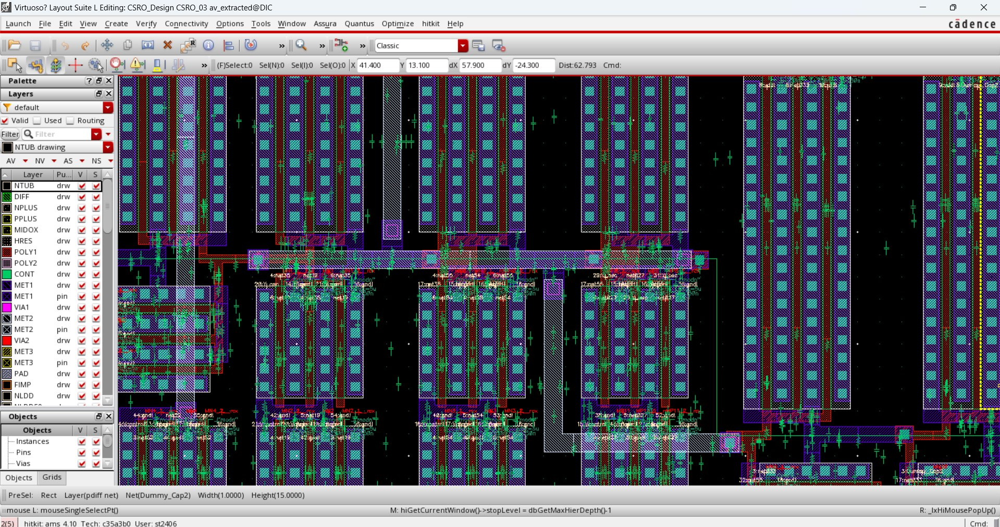

## 2.4 Backannotation of parasitics & Evaluation of Design Strategy

One of the design requirement was the balancing of the parasitics. Now after Layout through the stages of DRC, LVS and QRC, the parasitics can be backannotated. And the design strategy has worked! As can be seen (for closer look refer to second image), all the inverter stages see about the same capacitances - around 20fF. This is a significant improvement over early designs in this project. To draw a comparison refer to Appendix D: *Parasitcs in early design stage - Unbalanced!*, which was without the dummy buffer stages. There the parasitics were not balanced.

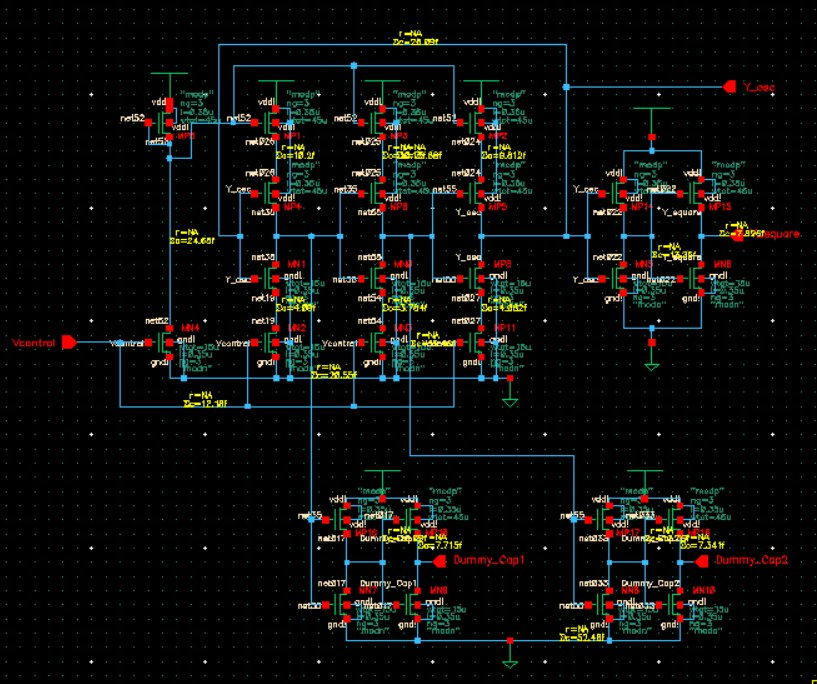

#### A closer look:

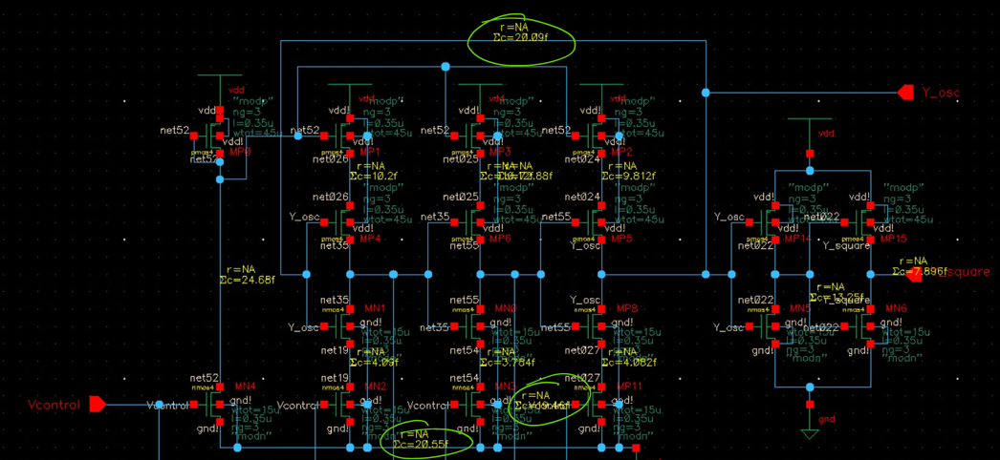

## 2.5 Post-Layout Simulation

Now with parasitcs extracted the post-layout simulation can be done.

**Important Note** on solver. Solver has to be chosen to be moderate or liberal, otherwise the solution will not converge. This could be because of the complexity of the circuit, which would require higher tolerances or lower convergence criteria.

### 2.5.1 Simulation under typical operating conditions
The given parameters for typical conditions are:

- $V_{DD}$ = 3.31 V

- $V_{ctrl}$ = 1.0V

- Temperature = 38°C

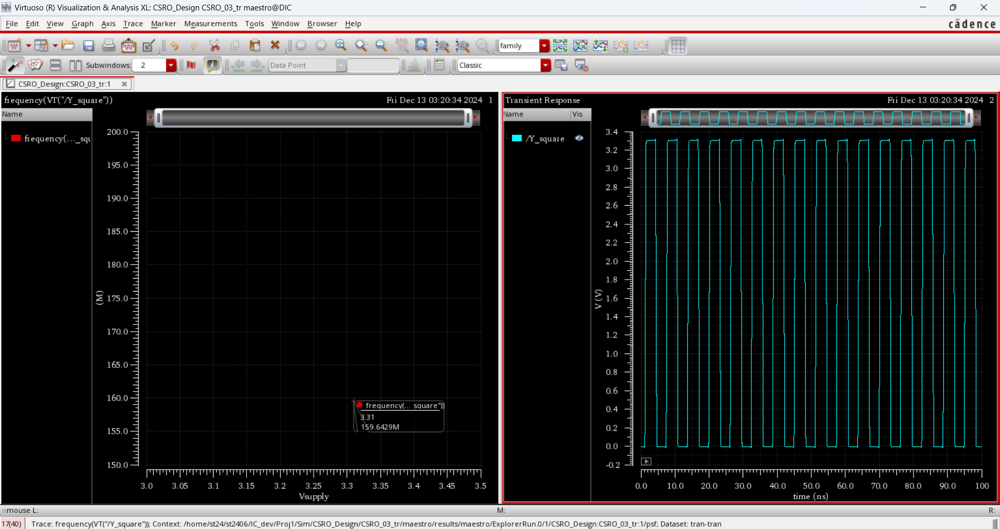

### 2.5.2 Simulation for $V_{ctrl}$: 0.7-1.4V


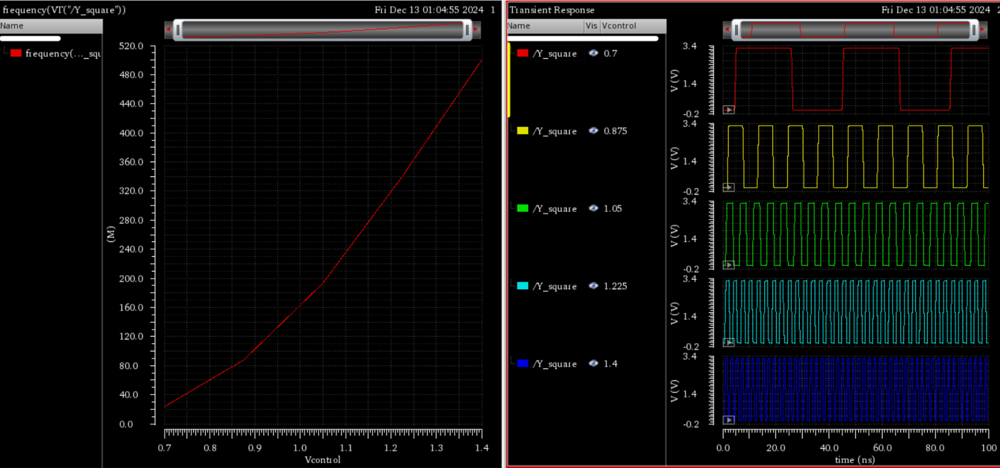

With these typical operating conditions the frequency is expected to be 159.6 MHz. The square outputwave can be observed on the right.

### 2.5.3 Comparisson to Pre-Layout Simulation

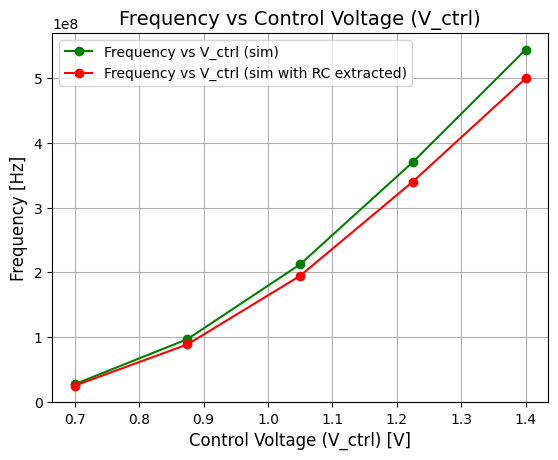

In [37]:


csv_file = 'freq_vs_vctr_parabalanced_1312mod.csv'

data = pd.read_csv(DIR+csv_file)

# Extract the data
freq_x = data['frequency(VT("/Y_square")) X']
freq_y = data['frequency(VT("/Y_square")) Y']

# Create the plot
plt.plot(freq_x, freq_y, marker='o', linestyle='-', color='g', label='Frequency vs V_ctrl (sim)')

csv_file = 'freq_vs_vctr_parabalanced_wRCI1312mod.csv'
data_wRC = pd.read_csv(DIR+csv_file)
# data_wRC = pd.read_csv(csv_file)

# Extract the data
freq_x = data_wRC['frequency(VT("/Y_square")) X']
freq_y = data_wRC['frequency(VT("/Y_square")) Y']

plt.plot(freq_x, freq_y, marker='o', linestyle='-', color='r', label='Frequency vs V_ctrl (sim with RC extracted)')

plt.title('Frequency vs Control Voltage (V_ctrl)', fontsize=14)
plt.xlabel('Control Voltage (V_ctrl) [V]', fontsize=12)
plt.ylabel('Frequency [Hz]', fontsize=12)
plt.grid(True)
plt.legend()


As can be seen, the frequency does decrease! This is expected as through the parasitic capacitances there is more capacitve load to be charged which slows the switching speed.

Additionally, the non negligible parasitic capacitances and resistances results in a longer propagation delay for the interconnects.

Another observation, is that the discrepencies in the frequencies between the two plots inncreases as V_ctrl increases. This is because the delays caused by the parasitics become more significant as the transistors switch faster and the circuits impedance is impacted by frequency.

Under typical operating conditions the frequency is around $9.2\%$ lower compared to the pre-extraction simulation.

# 3. Conclusion

Following the design objectives:
- Minimize Area
- Maintain Output Stability
- Maintain Circuit Stability
- Power efficiency

The basic ring oscillator design got expanded to a current-starved ring oscillator design. The frequency and power consumption of which can be controlled by $V_{ctrl}$. To satisfy the objective of output stability, an output buffer has been added to the design, granting load isolation, increased drive capacity for external loads and a consistency in phase with the original oscillaor signal.

To satisfy the objective of circuit stability and to balance the parasitcs introduced by the output buffer, two dummy buffer stages are introduced, leading to more balanced parasitics at the nodes of the VCO.

This design as been implemented in CMOS 0.35 μm technology optimizing layout area. The design is DRC and LVS clean and has been simulated under different operating conditions without and with extracted parasitics.

The design went through several iteration (to be found in appendix) each addressing the weaknesses of the previous one.
In the end we are happy with our result and we learned a lot about VCO design and the corresponding considerations, layout design, parasitcs, simulations, solver settings and more aspects of full custom IC-design techniques.

# 4. References
1:
Suman, S., Sharma, K. G., & Ghosh, P. K. (2016). Analysis and design of current starved ring VCO. 2016 International Conference on Electrical, Electronics, and Optimization Techniques (ICEEOT), 3222–3227. https://doi.org/10.1109/iceeot.2016.7755299

2:
Xiao, Z., Kisslinger, K., Chance, S., & Banks, S. (2020). Comparison of hafnium dioxide and zirconium dioxide grown by plasma-enhanced atomic layer deposition for the application of electronic materials. Crystals, 10(2), 136. https://doi.org/10.3390/cryst10020136

3:
Qiang Lu, Yee Chia Yeo, Yang, K. J., Lin, R., Polishchuk, I., Tsu-Jae King, Chenming Hu, Song, S. C., Luan, H. F., Dim-Lee Kwong, Xin Guo, Zhijiong Luo, Xiewen Wang, & Tso-Ping Ma. (2001). Two silicon nitride technologies for post-SiO2 Mosfet Gate Dielectric. IEEE Electron Device Letters, 22(7), 324–326. https://doi.org/10.1109/55.930679

# 5. Appendices

## Appendix A: Simplified Conceptual Circuit Drawing

*Note: To view the schematic, need to full screen the browser*

The figure below shows a conceptual circuit diagram drawn using the python library schemdraw.


In [38]:
!pip install schemdraw

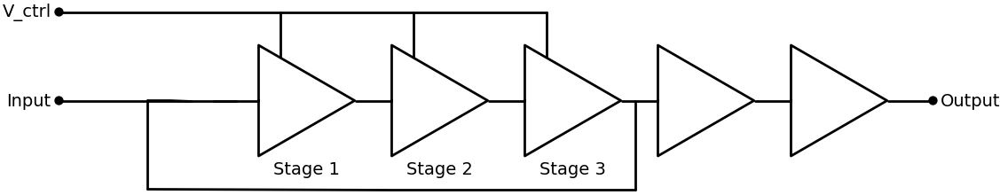

In [39]:
import schemdraw
import schemdraw.elements as elm

with schemdraw.Drawing() as d:
    # Starting position for the first inverter
    x = 0
    y = 0
    inverter_spacing = 3
    inverter_positions = []

    # Draw inverters (Opamps) in a line
    for i in range(5):
        if i == 1 or i == 2 or i == 0:
          inv = d.add(
              elm.Opamp(sign=False)
              .at((x, y))
              .label(f"Stage {i+1}", loc="bottom")
          )
        else:
          inv = d.add(
              elm.Opamp(sign=False)
              .at((x, y))
          )
        inverter_positions.append((x, y))
        x += inverter_spacing

    for i in range(4):
        # Approximate positions for the ends of the opamps
        start_pos = (inverter_positions[i][0] + 2.2, inverter_positions[i][1])
        end_pos = (inverter_positions[i+1][0], inverter_positions[i+1][1])
        d.add(elm.Line().at(start_pos).to(end_pos))

    # Draw feedback line from the last inverter back to the first inverter
    feedback_start = (inverter_positions[2][0] + 2.5, inverter_positions[2][1])
    d.add(elm.Line().at(feedback_start).down(2))
    d.add(elm.Line().left(x - inverter_spacing-1))
    d.add(elm.Line().up(2))
    feedback_end = (inverter_positions[0][0] - 1.5, inverter_positions[0][1])
    d.add(elm.Line().to(feedback_end))

    d.add(
        elm.Line()
        .at((inverter_positions[0][0] - 4.5, y))
        .to((inverter_positions[0][0] - 0.5, y))
    )

    d.add(
        elm.Line()
        .at((inverter_positions[4][0] + 2.2, y))
        .to((inverter_positions[4][0] + 3.2, y))
    )


    d.add(
        elm.Dot()
        .at((inverter_positions[0][0] - 4.5, y))
        .label("Input", loc="left")
    )

    d.add(
        elm.Dot()
        .at((inverter_positions[4][0] + 3.2, y))
        .label("Output", loc="right")
    )

    d.add(elm.Line().at((0,0)).to((-1,0)))
    # for pos in inverter_positions:
    for i in range(3):
      pos = inverter_positions[i]
      d.add(elm.Line().at((pos[0] + 0.5, pos[1] + 1.0)).up(1))
    rail_y = y + 2

    d.add(elm.Line().at((inverter_positions[0][0] - 4.5, rail_y)).to((inverter_positions[2][0] + 0.5, rail_y)))

    d.add(
        elm.Dot()
        .at((inverter_positions[0][0] -4.5, rail_y))
        .label("V_ctrl", loc="left")
    )

    d.draw()


## Appendix B: Python Code Simulation of Ideal Basic Schematic vs Final Schematic/Layout Simulations

Apart from having a simplified circuit drawing, we also realised the importance of running some pre-design simulations and calculations to have something to compare our designs and simulations in Cadence to.

The frequency of this current-starved ring oscillator is governed by the following equations [1]:

$$ f_{out} = \frac{I_d}  {2 * N * C_{total} * V_{ctrl}}  $$

$$$$
where $f_{out}$ is the output frequency, $I_d$ available for charging the capacative load of the next stage and $C_{total}$ is $C_{in} + C_{out}$ of the inverter.

$C_{total}$ is commonly estimated as:
$$ C_{total} = \frac{5}{2} * C_{ox} (W_p L_p  + W_n L_n)$$
$$ $$




***Note that this is the ideal frequency that is being calculated. It is the frequency of the core current starved ring oscillator, with no output buffer and no corresponding balancing dummy capacitances!***

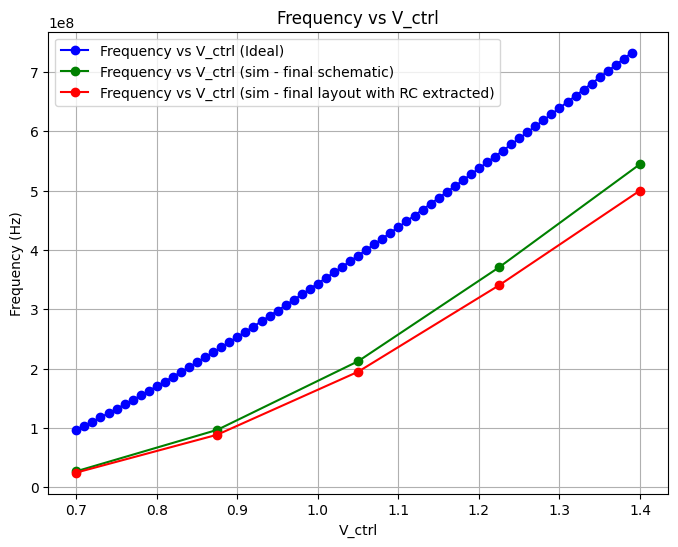

In [43]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

Wp = 45e-6
Wn = 15e-6
Lp = 0.35e-6
Ln = 0.35e-6
k = 9 # estimated using silicon nitride dialectric constant which is typically used for high performance or low power applications like in high-speed oscillators

eps_ox = 8.85e-12 * 3.97 # Alternatively with k
t_ox = 7.6e-9
Cox = eps_ox / t_ox
kn = 80e-6 * Wn / Ln

N = 3

C_total = Cox * (Wp * Lp + Wn * Ln) + 1.5 * Cox * (Wp * Lp + Wn * Ln) # from the paper

# def calculate_cap(V_ctrl, Wn, Ln, Wp, Lp):
#     Ctotal1_nmos = Wn * Ln * 0.84e-9 / ((1 + V_ctrl / 0.69)**0.34)
#     Ctotal2_nmos = 2 * (Wn + Ln) * 0.25e-9 / ((1 + V_ctrl / 0.69)**0.34)

#     Ctotal1_pmos = Wp * Lp * 1.36e-9 / ((1 + V_ctrl / 1.02)**0.54)
#     Ctotal2_pmos = 2 * (Wp + Lp) * 0.35e-9 / ((1 + V_ctrl / 1.02)**0.46)

#     return Ctotal1_nmos + Ctotal2_nmos + Ctotal1_pmos + Ctotal2_pmos



V_th = 0.46

# Function to calculate frequency based on regime
def calculate_freq(kn, V_ctrl, V_th, C_total, N):
    V_ds = V_ctrl - V_th  # Approximation for linear regime
    if V_ctrl > V_th:
        if V_ds < V_ctrl - V_th:  # Linear regime
            return kn * (V_ctrl - V_th) * V_ds / (2 * N * C_total * V_ctrl)
        else:  # Saturation regime
            return kn * (V_ctrl - V_th)**2 / (4 * N * C_total * V_ctrl)
    else:
        return 0  # No oscillation below threshold

freq_list = []
V_ctrl_list = []
V_ctrl_list = np.arange(0.7, 1.4, 0.01)
for V_ctrl in V_ctrl_list:
    # C_total = calculate_cap(V_ctrl, Wn, Ln, Wp, Lp)
    freq = calculate_freq(kn, V_ctrl, V_th, C_total, N)
    freq_list.append(freq)


plt.figure(figsize=(8, 6))
plt.plot(V_ctrl_list, freq_list, marker='o', color='b', label='Frequency vs V_ctrl (Ideal)')


csv_file = 'freq_vs_vctr_parabalanced_1312mod.csv'

data = pd.read_csv(DIR+csv_file)

# Extract the data
freq_x = data['frequency(VT("/Y_square")) X']
freq_y = data['frequency(VT("/Y_square")) Y']

# Create the plot
plt.plot(freq_x, freq_y, marker='o', linestyle='-', color='g', label='Frequency vs V_ctrl (sim - final schematic)')

csv_file = 'freq_vs_vctr_parabalanced_wRCI1312mod.csv'
data_wRC = pd.read_csv(DIR+csv_file)
# data_wRC = pd.read_csv(csv_file)

# Extract the data
freq_x = data_wRC['frequency(VT("/Y_square")) X']
freq_y = data_wRC['frequency(VT("/Y_square")) Y']

plt.plot(freq_x, freq_y, marker='o', linestyle='-', color='r', label='Frequency vs V_ctrl (sim - final layout with RC extracted)')


### Experimental



plt.legend()
plt.xlabel('V_ctrl')
plt.ylabel('Frequency (Hz)')
plt.title('Frequency vs V_ctrl')
plt.grid(True)
plt.show()



## Appendix C: Conceptual Early Stick Diagram

Based on the circuit schematic for our design, we came up with the stick diagram which would help in the implementation for the layout. For the stick diagram notation, we considered the following:

-	P-diffusion/pdiff (Green) for the PMOS transistors, located at the top, connected to VDD (power supply).
-	N-diffusion/ndiff (Yellow) for the NMOS transistors, located at the bottom, connected to GND (ground).
- Poly lines/polysilicon (Red) which represent the gate terminals for each transistor and control the inputs (A and B).
- Metal-1 (Blue) for routing the signals and interconnects between different components.
- Metal-2 (Grey) for routing the signals and interconnects between different components.

To make the stick diagram clearer, we made sure that everything was labelled and colour coded the different lines to show the differences in the layers. We also considered the simplicity and designed it so that there was little unnecessary overlapping or overcrowding, making it more straightforward to understand.

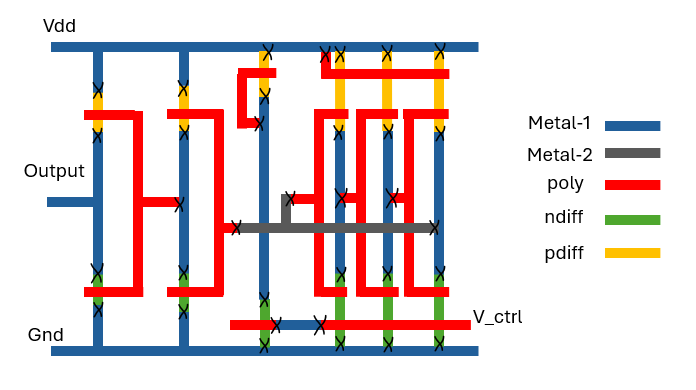

## Appendix D: Gallery of Design Iterations

### Early Design Stages

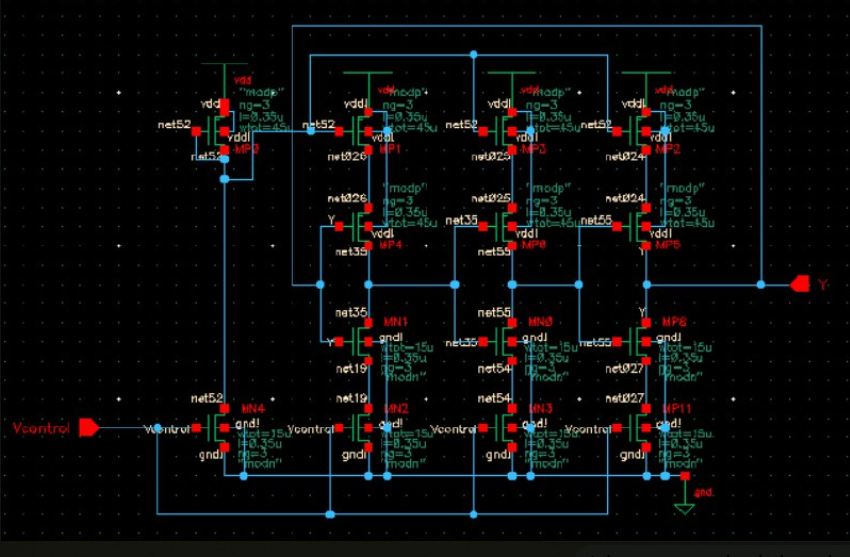

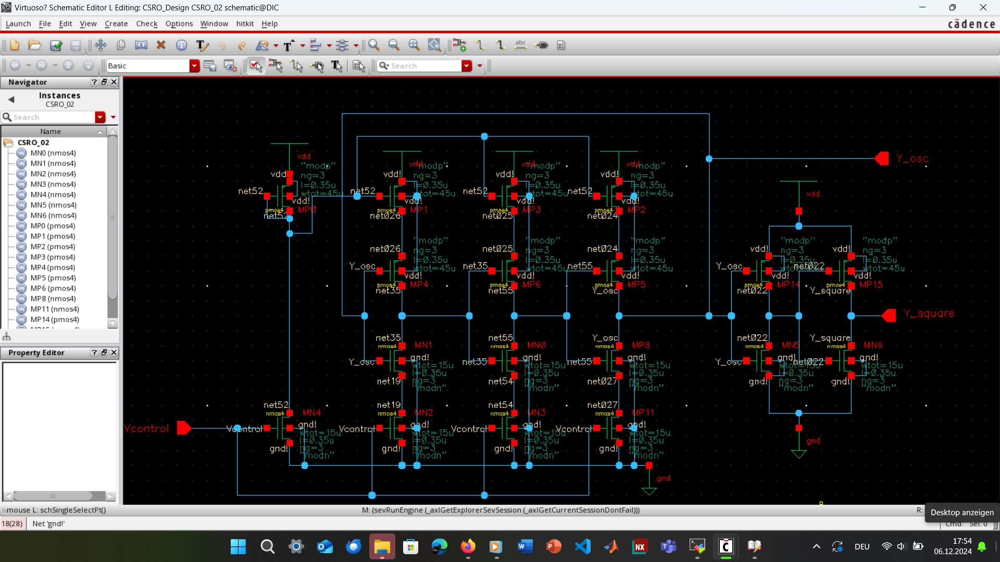

### Layout Design Iterations
From basic current-starved VCO to inclusion of the output buffer. All of which have been simulated and lead to the final layout.

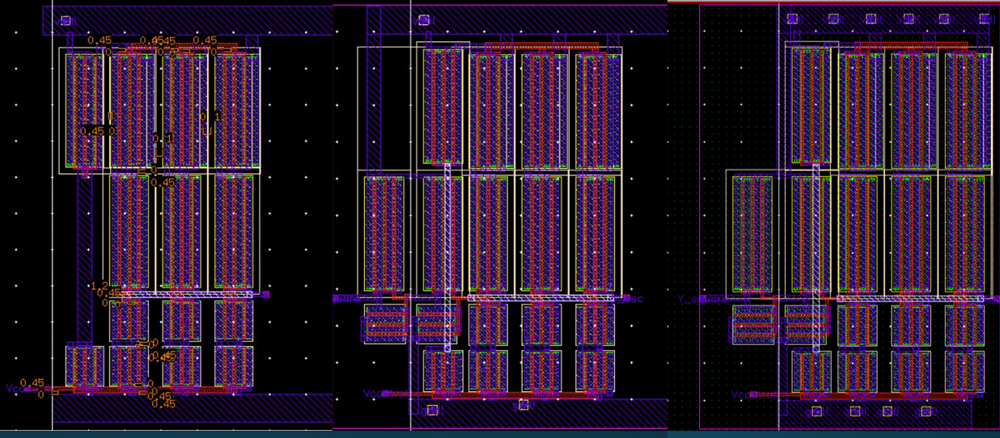

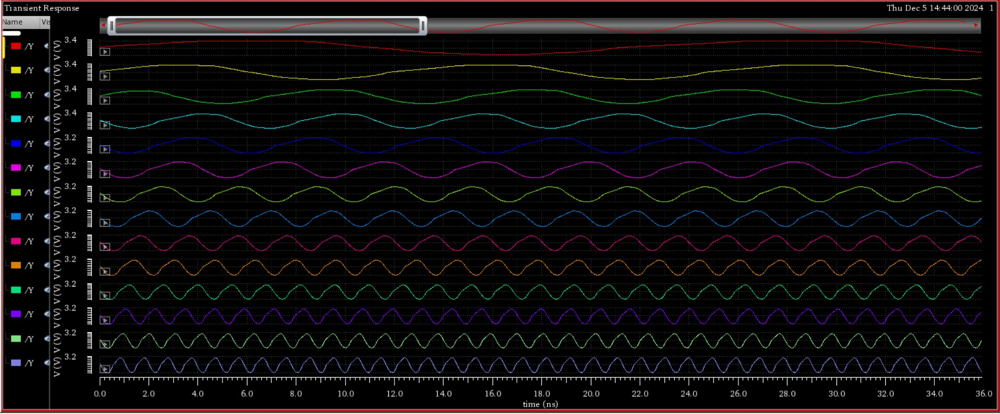

### Parasitcs in early design stage - Unbalanced!

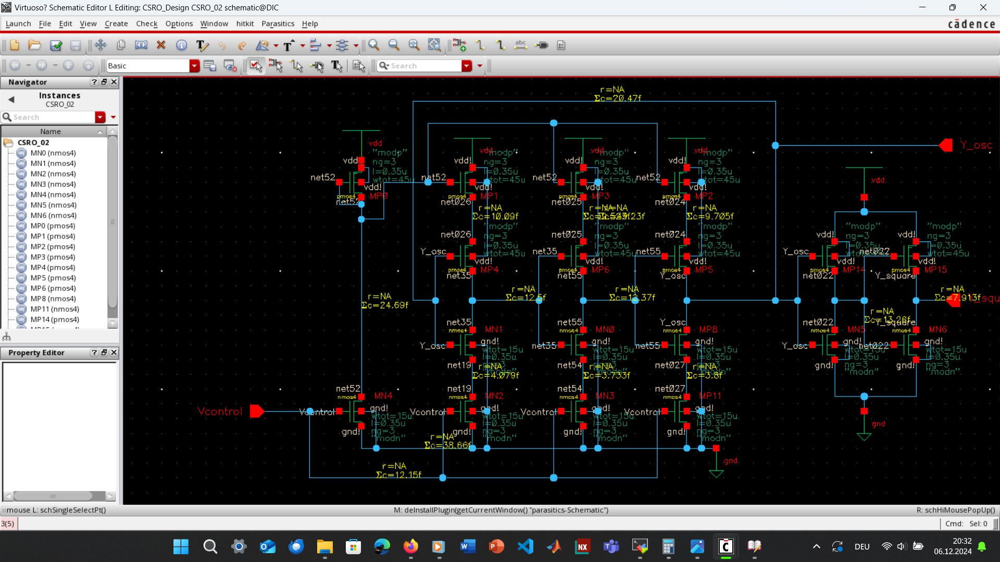

## Appendix E: Alternative iterations of the layout and schematic

alternative iteration 1:

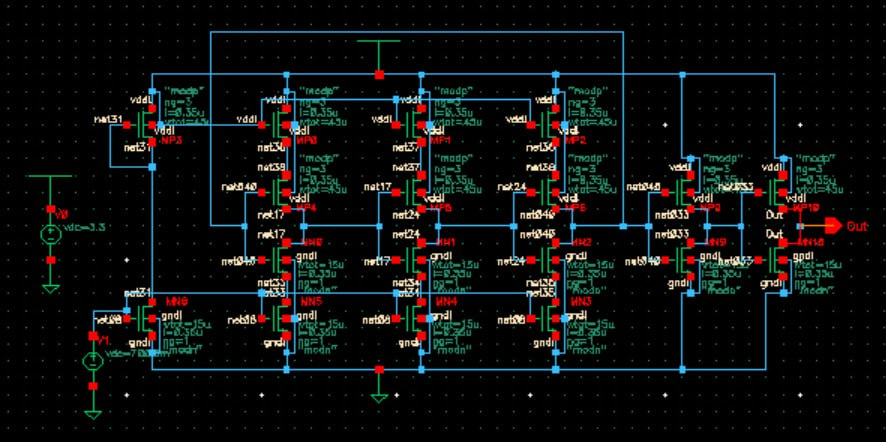

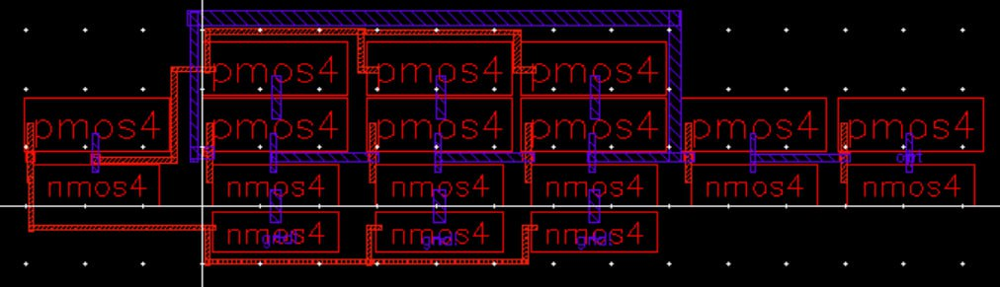

alternative iteration 2:

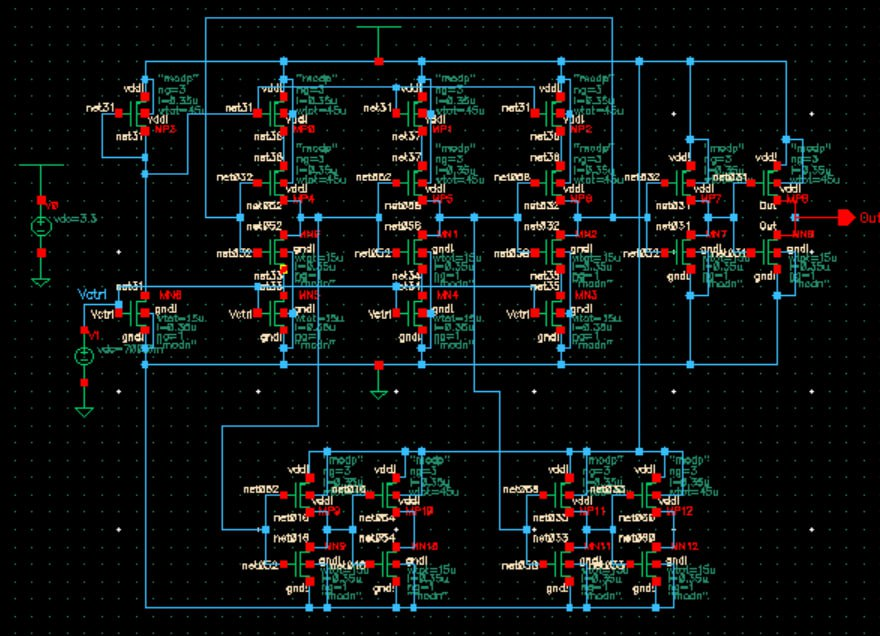

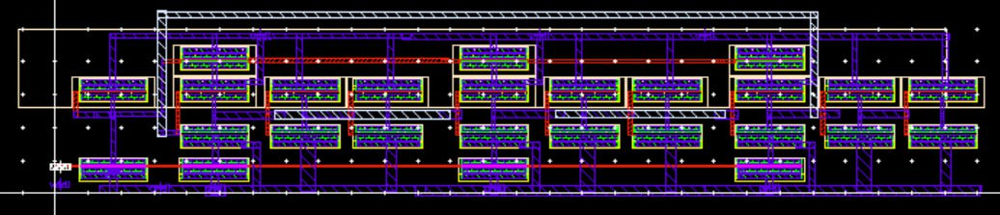